In [1]:
import trimesh
import numpy as np
from collections import defaultdict
import open3d as o3d

# 🎯 Define ideal class colors
COLOR_CLASSES = {
    "Lower Teeth": np.array([250, 250, 0]),
    "Left Mandibular": np.array([255, 0, 0]),
    "Right Mandibular": np.array([0, 0, 255])
}

def closest_class(rgb):
    distances = {name: np.linalg.norm(rgb - ref_rgb) for name, ref_rgb in COLOR_CLASSES.items()}
    return min(distances, key=distances.get)

def analyze_and_fix_classes(ply_path):
    print(f"\n📂 Analyzing voxel-based segmentation from: {ply_path}")
    mesh = trimesh.load(ply_path, process=False)

    if not hasattr(mesh, 'vertices') or not hasattr(mesh, 'faces'):
        print("❌ No valid mesh structure in PLY.")
        return

    colors = mesh.visual.vertex_colors  # (N, 4)
    if colors is None or len(colors) == 0:
        print("❗ No vertex colors found.")
        return

    rgb_colors = colors[:, :3].astype(np.float32)
    class_assignment = defaultdict(int)

    for color in rgb_colors:
        label = closest_class(color)
        class_assignment[label] += 1

    print(f"\n✅ Cleaned Class Summary:")
    for class_name, count in class_assignment.items():
        print(f"🔹 {class_name}: {count} voxels")

    if mesh.is_volume:
        print(f"\n📦 Detected voxel mesh with volume: {mesh.volume:.2f}")
    else:
        print("\n📎 No volume detected — not a voxel mesh.")

    # Optional: Visualize
    print("\n🖼️ Launching 3D viewer...")
    o3d_mesh = o3d.io.read_triangle_mesh(ply_path)
    o3d_mesh.compute_vertex_normals()
    o3d.visualization.draw_geometries([o3d_mesh])

# -----------------------------
# 🧪 Example usage
# -----------------------------
ply_path = r"C:\Users\ravimolake\Downloads\mesh mandibular segmentator\DentalSegDataset\labelTr\134637 Segmentation.ply"
analyze_and_fix_classes(ply_path)


Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.

📂 Analyzing voxel-based segmentation from: C:\Users\ravimolake\Downloads\mesh mandibular segmentator\DentalSegDataset\labelTr\134637 Segmentation.ply

✅ Cleaned Class Summary:
🔹 Lower Teeth: 56171 voxels
🔹 Right Mandibular: 4167 voxels
🔹 Left Mandibular: 3845 voxels

📦 Detected voxel mesh with volume: 5793.51

🖼️ Launching 3D viewer...


In [2]:
import trimesh
import os

stl_path = r"C:\Users\ravimolake\Downloads\mesh mandibular segmentator\DentalSegDataset\labelTr\134637 Segmentation.ply"  # <-- Replace with an actual file path

mesh = trimesh.load(stl_path, process=False)

print(f"📂 File: {os.path.basename(stl_path)}")
print(f"📐 Vertices: {mesh.vertices.shape}")
print(f"🔺 Faces: {mesh.faces.shape}")

# Check if color exists
has_color = hasattr(mesh.visual, 'vertex_colors') and mesh.visual.vertex_colors is not None
print(f"🎨 Has vertex colors: {has_color}")


📂 File: 134637 Segmentation.ply
📐 Vertices: (64183, 3)
🔺 Faces: (128350, 3)
🎨 Has vertex colors: True


In [3]:
from trimesh import load

image_file = r"C:\Users\ravimolake\Downloads\mesh mandibular segmentator\DentalSegDataset\imagesTr\134637 AXIAL_Segmentation.stl"
label_file = r"C:\Users\ravimolake\Downloads\mesh mandibular segmentator\DentalSegDataset\imagesTr\134637 AXIAL_Segmentation.stl"

img_mesh = load(image_file, process=False)
lbl_mesh = load(label_file, process=False)

print("\n📏 Bounding box of Raw STL:")
print(img_mesh.bounds)

print("\n📏 Bounding box of Label PLY:")
print(lbl_mesh.bounds)



📏 Bounding box of Raw STL:
[[ 3.05239153 10.08891106 12.98784256]
 [73.28543854 65.09979248 42.5154686 ]]

📏 Bounding box of Label PLY:
[[ 3.05239153 10.08891106 12.98784256]
 [73.28543854 65.09979248 42.5154686 ]]


In [4]:
import open3d as o3d

# Load STL (image)
stl = o3d.io.read_triangle_mesh(r"C:\Users\ravimolake\Downloads\mesh mandibular segmentator\DentalSegDataset\imagesTr\134637 AXIAL_Segmentation.stl")
stl.paint_uniform_color([0.7, 0.7, 0.7])  # Gray

# Load PLY (label)
ply = o3d.io.read_triangle_mesh(r"C:\Users\ravimolake\Downloads\mesh mandibular segmentator\DentalSegDataset\imagesTr\134637 AXIAL_Segmentation.stl")

# Visualize together
o3d.visualization.draw_geometries([stl, ply])


In [5]:
# ✅ MeshSegNet Training Pipeline for Dental Segmentation
# ---------------------------------------------------------
# This code uses .PLY files from labelTr folder with vertex colors.
# Converts to PyTorch Geometric format, trains a MeshSegNet, and reports accuracy.

import os
import numpy as np
import trimesh
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.data import Data
from torch_geometric.loader import DataLoader  # ✅ Use new loader
from torch_geometric.nn import GCNConv
from scipy.spatial import cKDTree
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from tqdm import tqdm
import joblib

# -----------------------------------
# 🧾 1. Color to Class ID Mapping
# -----------------------------------
COLOR_TO_CLASS = {
    (250, 250, 0): 1,   # Lower Teeth
    (255, 0, 0): 2,     # Left Mandibular
    (0, 0, 255): 3      # Right Mandibular
}

# 🧠 Robust RGB to class ID mapping
def closest_color_class(rgb):
    min_dist = float('inf')
    class_id = 0  # default: background
    for known_rgb, cid in COLOR_TO_CLASS.items():
        dist = np.linalg.norm(np.array(rgb) - np.array(known_rgb))
        if dist < min_dist:
            min_dist = dist
            class_id = cid
    return class_id
    


# -----------------------------------
# 🧱 2. MeshSegNet Model
# -----------------------------------
class MeshSegNet(nn.Module):
    def __init__(self, in_channels=3, num_classes=3):
        super(MeshSegNet, self).__init__()
        self.conv1 = GCNConv(in_channels, 64)
        self.conv2 = GCNConv(64, 128)
        self.conv3 = GCNConv(128, 256)
        self.classifier = nn.Linear(256, num_classes)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = torch.relu(self.conv1(x, edge_index))
        x = torch.relu(self.conv2(x, edge_index))
        x = torch.relu(self.conv3(x, edge_index))
        x = self.classifier(x)
        return x

# -----------------------------------
# 🧪 3. Load PLY as PyG Data
# -----------------------------------
def load_ply_as_data(ply_path):
    mesh = trimesh.load(ply_path, process=False)
    vertices = torch.tensor(mesh.vertices, dtype=torch.float)
    faces = torch.tensor(mesh.faces, dtype=torch.long).T  # (3, N)

    # Generate edges
    edge_index = torch.cat([faces[:2], faces[1:], faces[[0, 2]]], dim=1)

    # Vertex color to class using robust matching
    colors = mesh.visual.vertex_colors[:, :3]
    raw_labels = torch.tensor([closest_color_class(c) for c in colors], dtype=torch.long)

    # ✅ Remap [1,2,3] → [0,1,2]
    remapped_labels = raw_labels - 1

    return Data(x=vertices, edge_index=edge_index, y=remapped_labels)


# -----------------------------------
# 📦 4. Prepare Dataset with Caching
# -----------------------------------
def load_dataset(folder, cache_path="meshsegnet_dataset_cache.pkl", force_reload=False):
    if not force_reload and os.path.exists(cache_path):
        print("🔄 Loading dataset from cache...")
        return joblib.load(cache_path)
    else:
        print("📥 Processing dataset from PLY files...")
        files = sorted([os.path.join(folder, f) for f in os.listdir(folder) if f.endswith('.ply')])
        data_list = [load_ply_as_data(f) for f in tqdm(files, desc="Processing PLYs")]
        joblib.dump(data_list, cache_path)
        print("✅ Dataset cached.")
        return data_list
        
if os.path.exists("meshsegnet_dataset_cache.pkl"):
    os.remove("meshsegnet_dataset_cache.pkl")  # ✅ delete broken/empty cache file
    print("deleted file")


train_folder = r"C:\Users\ravimolake\Downloads\mesh mandibular segmentator\DentalSegDataset\labelTr"
data_list = load_dataset(train_folder, force_reload=True)  # ✅ force reprocess if needed


# Split
# train_data = data_list[:30]  # Change based on your actual count
# val_data = data_list[30:]

# Split with random shuffle
train_data, val_data = train_test_split(
    data_list,
    test_size=0.2,         # 20% for validation
    random_state=42,       # ensures reproducibility
    shuffle=True
)

train_loader = DataLoader(train_data, batch_size=1, shuffle=True)
val_loader = DataLoader(val_data, batch_size=1)



deleted file
📥 Processing dataset from PLY files...


Processing PLYs: 100%|█████████████████████████████████████████████████████████████████| 37/37 [04:09<00:00,  6.76s/it]


✅ Dataset cached.


In [6]:
import torch
from tqdm import tqdm

# 📊 Class label tracker
all_labels = []

# 🔍 Check through entire training + validation set
for loader_name, loader in [("Train", train_loader), ("Val", val_loader)]:
    print(f"\n🔍 Scanning {loader_name} Dataset...")
    for batch in tqdm(loader):
        y = batch.y  # shape: [N]
        unique = torch.unique(y)
        all_labels.extend(unique.cpu().numpy())

# 🧾 Collect and print unique class labels
all_classes = sorted(set(all_labels))
print(f"\n🧪 Unique labels in dataset: {all_classes}")

if 0 in all_classes:
    print("⚠️ Class 0 (background) is present in your dataset.")
else:
    print("✅ No background (class 0) found. You can safely ignore it.")



🔍 Scanning Train Dataset...


100%|██████████████████████████████████████████████████████████████████████████████████| 29/29 [00:00<00:00, 78.76it/s]



🔍 Scanning Val Dataset...


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:00<00:00, 57.55it/s]


🧪 Unique labels in dataset: [0, 1, 2]
⚠️ Class 0 (background) is present in your dataset.


In [7]:
import torch
import numpy as np
from tqdm import tqdm
from sklearn.metrics import classification_report, f1_score
from monai.losses import DiceLoss, FocalLoss

# -----------------------------
# 🧠 Model Setup
# -----------------------------
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = MeshSegNet(num_classes=3).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

# -----------------------------
# ⚖️ Weighted Dice + Focal Loss
# -----------------------------
dice_loss = DiceLoss(
    to_onehot_y=True,
    softmax=True,
    include_background=True,
    weight=torch.tensor([1.0, 4.0, 4.0]).to(device)
)

focal_loss = FocalLoss(
    to_onehot_y=True,
    weight=torch.tensor([1.0, 4.0, 4.0]).to(device)
)

def loss_fn(pred, target):
    return 0.5 * dice_loss(pred, target) + 0.5 * focal_loss(pred, target)

# -----------------------------
# 📊 Metric Tracking Initialization
# -----------------------------
total_losses = []
dice_scores_class1 = []
dice_scores_class2 = []
dice_scores_class3 = []
avg_dice_scores = []
overall_accuracies = []

best_dice = 0.0

# -----------------------------
# 🏋️‍♂️ Training Loop
# -----------------------------
for epoch in range(1, 21):
    model.train()
    total_loss = 0
    train_iter = tqdm(train_loader, desc=f"Epoch {epoch}", leave=False)

    for batch in train_iter:
        batch = batch.to(device)
        out = model(batch)  # [N, 3]
        loss = loss_fn(out, batch.y)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()
        train_iter.set_postfix(loss=loss.item())

    print(f"\n📉 Epoch {epoch} | Total Loss: {total_loss:.4f}")

    # -----------------------------
    # 📊 Validation
    # -----------------------------
    model.eval()
    all_preds, all_labels = [], []

    with torch.no_grad():
        for batch in val_loader:
            batch = batch.to(device)
            out = model(batch)
            preds = out.argmax(dim=1)
            labels = batch.y

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    # 🔁 Remap [0,1,2] → [1,2,3] for reporting
    all_preds = [p + 1 for p in all_preds]
    all_labels = [l + 1 for l in all_labels]

    print("\n📊 Validation Report:")
    print(classification_report(
        all_labels,
        all_preds,
        labels=[1, 2, 3],
        target_names=["Teeth", "Left Canal", "Right Canal"],
        zero_division=0
    ))

    print("🎯 Dice per class:")
    dice_scores = []
    for cls in [1, 2, 3]:
        cls_dice = f1_score(
            np.array(all_labels) == cls,
            np.array(all_preds) == cls
        )
        dice_scores.append(cls_dice)
        print(f"Class {cls} Dice: {cls_dice:.3f}")

    class_1_dice = dice_scores[0]
    class_2_dice = dice_scores[1]
    class_3_dice = dice_scores[2]
    avg_dice = np.mean(dice_scores)

    # ✅ Save best model
    if avg_dice > best_dice:
        best_dice = avg_dice
        torch.save(model.state_dict(), "best_meshsegnet_model.pth")
        print(f"💾 Best model saved with Avg Dice: {avg_dice:.4f}")

    # ✅ Accuracy
    overall_acc = np.mean(np.array(all_preds) == np.array(all_labels)) * 100
    print(f"✅ Overall Accuracy: {overall_acc:.2f}%")

    # -----------------------------
    # 📌 Save Metrics for Graphs
    # -----------------------------
    total_losses.append(total_loss)
    dice_scores_class1.append(class_1_dice)
    dice_scores_class2.append(class_2_dice)
    dice_scores_class3.append(class_3_dice)
    avg_dice_scores.append(avg_dice)
    overall_accuracies.append(overall_acc)

# -----------------------------
# ✅ Final Summary After Training
# -----------------------------
best_epoch = np.argmax(avg_dice_scores)
print("\n📈 Training Complete!")
print(f"🏆 Best Model at Epoch {best_epoch + 1}")
print(f"   • Total Loss      : {total_losses[best_epoch]:.4f}")
print(f"   • Dice - Teeth    : {dice_scores_class1[best_epoch]:.4f}")
print(f"   • Dice - Left Canal : {dice_scores_class2[best_epoch]:.4f}")
print(f"   • Dice - Right Canal: {dice_scores_class3[best_epoch]:.4f}")
print(f"   • Avg Dice        : {avg_dice_scores[best_epoch]:.4f}")
print(f"   • Accuracy        : {overall_accuracies[best_epoch]:.2f}%")


C:\Users\ravimolake\anaconda3\Lib\site-packages\paramiko\pkey.py:82: CryptographyDeprecationWarning: TripleDES has been moved to cryptography.hazmat.decrepit.ciphers.algorithms.TripleDES and will be removed from this module in 48.0.0.
  "cipher": algorithms.TripleDES,
C:\Users\ravimolake\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been moved to cryptography.hazmat.decrepit.ciphers.algorithms.Blowfish and will be removed from this module in 45.0.0.
  "class": algorithms.Blowfish,
C:\Users\ravimolake\anaconda3\Lib\site-packages\paramiko\transport.py:243: CryptographyDeprecationWarning: TripleDES has been moved to cryptography.hazmat.decrepit.ciphers.algorithms.TripleDES and will be removed from this module in 48.0.0.
  "class": algorithms.TripleDES,



📉 Epoch 1 | Total Loss: 22.5115

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.90      0.87      0.88    506830
  Left Canal       0.22      0.53      0.31     34480
 Right Canal       0.00      0.00      0.00     35509

    accuracy                           0.80    576819
   macro avg       0.37      0.47      0.40    576819
weighted avg       0.80      0.80      0.79    576819

🎯 Dice per class:
Class 1 Dice: 0.883
Class 2 Dice: 0.310
Class 3 Dice: 0.000
💾 Best model saved with Avg Dice: 0.3977
✅ Overall Accuracy: 79.75%



📉 Epoch 2 | Total Loss: 11.6302

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.90      0.98      0.94    506830
  Left Canal       0.57      0.36      0.44     34480
 Right Canal       1.00      0.01      0.02     35509

    accuracy                           0.88    576819
   macro avg       0.82      0.45      0.47    576819
weighted avg       0.88      0.88      0.85    576819

🎯 Dice per class:
Class 1 Dice: 0.937
Class 2 Dice: 0.443
Class 3 Dice: 0.015
💾 Best model saved with Avg Dice: 0.4652
✅ Overall Accuracy: 88.45%



📉 Epoch 3 | Total Loss: 10.3592

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.89      0.99      0.93    506830
  Left Canal       0.50      0.20      0.28     34480
 Right Canal       0.00      0.00      0.00     35509

    accuracy                           0.88    576819
   macro avg       0.46      0.39      0.41    576819
weighted avg       0.81      0.88      0.84    576819

🎯 Dice per class:
Class 1 Dice: 0.935
Class 2 Dice: 0.281
Class 3 Dice: 0.000
✅ Overall Accuracy: 87.86%



📉 Epoch 4 | Total Loss: 7.3214

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.92      0.98      0.95    506830
  Left Canal       0.59      0.40      0.47     34480
 Right Canal       0.93      0.38      0.54     35509

    accuracy                           0.91    576819
   macro avg       0.81      0.59      0.65    576819
weighted avg       0.90      0.91      0.90    576819

🎯 Dice per class:
Class 1 Dice: 0.951
Class 2 Dice: 0.475
Class 3 Dice: 0.539
💾 Best model saved with Avg Dice: 0.6550
✅ Overall Accuracy: 90.95%



📉 Epoch 5 | Total Loss: 7.3115

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.92      0.99      0.95    506830
  Left Canal       0.60      0.38      0.46     34480
 Right Canal       0.93      0.35      0.51     35509

    accuracy                           0.91    576819
   macro avg       0.82      0.57      0.64    576819
weighted avg       0.90      0.91      0.90    576819

🎯 Dice per class:
Class 1 Dice: 0.953
Class 2 Dice: 0.465
Class 3 Dice: 0.511
✅ Overall Accuracy: 91.08%



📉 Epoch 6 | Total Loss: 7.2357

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.93      0.98      0.96    506830
  Left Canal       0.64      0.40      0.49     34480
 Right Canal       0.83      0.48      0.61     35509

    accuracy                           0.92    576819
   macro avg       0.80      0.62      0.69    576819
weighted avg       0.91      0.92      0.91    576819

🎯 Dice per class:
Class 1 Dice: 0.957
Class 2 Dice: 0.494
Class 3 Dice: 0.608
💾 Best model saved with Avg Dice: 0.6862
✅ Overall Accuracy: 91.71%



📉 Epoch 7 | Total Loss: 6.9186

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.92      0.99      0.95    506830
  Left Canal       0.62      0.33      0.43     34480
 Right Canal       0.98      0.35      0.51     35509

    accuracy                           0.91    576819
   macro avg       0.84      0.55      0.63    576819
weighted avg       0.90      0.91      0.89    576819

🎯 Dice per class:
Class 1 Dice: 0.950
Class 2 Dice: 0.428
Class 3 Dice: 0.510
✅ Overall Accuracy: 90.76%



📉 Epoch 8 | Total Loss: 7.7483

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.94      0.97      0.95    506830
  Left Canal       0.51      0.47      0.49     34480
 Right Canal       0.89      0.48      0.62     35509

    accuracy                           0.91    576819
   macro avg       0.78      0.64      0.69    576819
weighted avg       0.91      0.91      0.90    576819

🎯 Dice per class:
Class 1 Dice: 0.953
Class 2 Dice: 0.489
Class 3 Dice: 0.619
💾 Best model saved with Avg Dice: 0.6868
✅ Overall Accuracy: 91.06%



📉 Epoch 9 | Total Loss: 7.1223

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.92      0.98      0.95    506830
  Left Canal       0.55      0.40      0.47     34480
 Right Canal       0.95      0.33      0.49     35509

    accuracy                           0.91    576819
   macro avg       0.81      0.57      0.64    576819
weighted avg       0.90      0.91      0.89    576819

🎯 Dice per class:
Class 1 Dice: 0.951
Class 2 Dice: 0.466
Class 3 Dice: 0.489
✅ Overall Accuracy: 90.64%



📉 Epoch 10 | Total Loss: 8.5168

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.90      0.99      0.94    506830
  Left Canal       0.54      0.37      0.44     34480
 Right Canal       1.00      0.03      0.06     35509

    accuracy                           0.89    576819
   macro avg       0.82      0.46      0.48    576819
weighted avg       0.89      0.89      0.86    576819

🎯 Dice per class:
Class 1 Dice: 0.943
Class 2 Dice: 0.440
Class 3 Dice: 0.058
✅ Overall Accuracy: 89.00%



📉 Epoch 11 | Total Loss: 8.5260

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.94      0.98      0.96    506830
  Left Canal       0.64      0.43      0.52     34480
 Right Canal       0.79      0.57      0.66     35509

    accuracy                           0.92    576819
   macro avg       0.79      0.66      0.71    576819
weighted avg       0.91      0.92      0.92    576819

🎯 Dice per class:
Class 1 Dice: 0.960
Class 2 Dice: 0.516
Class 3 Dice: 0.665
💾 Best model saved with Avg Dice: 0.7136
✅ Overall Accuracy: 92.23%



📉 Epoch 12 | Total Loss: 6.8035

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.92      0.98      0.95    506830
  Left Canal       0.57      0.40      0.47     34480
 Right Canal       0.98      0.27      0.43     35509

    accuracy                           0.90    576819
   macro avg       0.82      0.55      0.62    576819
weighted avg       0.90      0.90      0.89    576819

🎯 Dice per class:
Class 1 Dice: 0.950
Class 2 Dice: 0.473
Class 3 Dice: 0.428
✅ Overall Accuracy: 90.48%



📉 Epoch 13 | Total Loss: 7.3068

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.94      0.98      0.96    506830
  Left Canal       0.61      0.44      0.51     34480
 Right Canal       0.88      0.53      0.66     35509

    accuracy                           0.92    576819
   macro avg       0.81      0.65      0.71    576819
weighted avg       0.91      0.92      0.91    576819

🎯 Dice per class:
Class 1 Dice: 0.959
Class 2 Dice: 0.514
Class 3 Dice: 0.658
✅ Overall Accuracy: 92.11%



📉 Epoch 14 | Total Loss: 6.6433

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.92      0.98      0.95    506830
  Left Canal       0.58      0.40      0.47     34480
 Right Canal       0.93      0.35      0.51     35509

    accuracy                           0.91    576819
   macro avg       0.81      0.58      0.65    576819
weighted avg       0.90      0.91      0.90    576819

🎯 Dice per class:
Class 1 Dice: 0.952
Class 2 Dice: 0.471
Class 3 Dice: 0.513
✅ Overall Accuracy: 90.88%



📉 Epoch 15 | Total Loss: 6.5405

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.92      0.98      0.95    506830
  Left Canal       0.56      0.41      0.48     34480
 Right Canal       0.98      0.27      0.42     35509

    accuracy                           0.90    576819
   macro avg       0.82      0.56      0.62    576819
weighted avg       0.90      0.90      0.89    576819

🎯 Dice per class:
Class 1 Dice: 0.950
Class 2 Dice: 0.477
Class 3 Dice: 0.422
✅ Overall Accuracy: 90.48%



📉 Epoch 16 | Total Loss: 6.5406

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.95      0.97      0.96    506830
  Left Canal       0.63      0.43      0.51     34480
 Right Canal       0.74      0.65      0.69     35509

    accuracy                           0.92    576819
   macro avg       0.77      0.69      0.72    576819
weighted avg       0.91      0.92      0.92    576819

🎯 Dice per class:
Class 1 Dice: 0.959
Class 2 Dice: 0.512
Class 3 Dice: 0.693
💾 Best model saved with Avg Dice: 0.7213
✅ Overall Accuracy: 92.11%



📉 Epoch 17 | Total Loss: 7.5563

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.95      0.96      0.96    506830
  Left Canal       0.55      0.54      0.54     34480
 Right Canal       0.68      0.66      0.67     35509

    accuracy                           0.91    576819
   macro avg       0.73      0.72      0.72    576819
weighted avg       0.91      0.91      0.91    576819

🎯 Dice per class:
Class 1 Dice: 0.955
Class 2 Dice: 0.542
Class 3 Dice: 0.670
💾 Best model saved with Avg Dice: 0.7223
✅ Overall Accuracy: 91.35%



📉 Epoch 18 | Total Loss: 6.4464

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.93      0.98      0.96    506830
  Left Canal       0.62      0.49      0.55     34480
 Right Canal       0.90      0.40      0.56     35509

    accuracy                           0.92    576819
   macro avg       0.82      0.63      0.69    576819
weighted avg       0.91      0.92      0.91    576819

🎯 Dice per class:
Class 1 Dice: 0.957
Class 2 Dice: 0.547
Class 3 Dice: 0.556
✅ Overall Accuracy: 91.70%



📉 Epoch 19 | Total Loss: 6.9059

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.92      0.98      0.95    506830
  Left Canal       0.60      0.40      0.48     34480
 Right Canal       0.93      0.39      0.55     35509

    accuracy                           0.91    576819
   macro avg       0.82      0.59      0.66    576819
weighted avg       0.91      0.91      0.90    576819

🎯 Dice per class:
Class 1 Dice: 0.953
Class 2 Dice: 0.482
Class 3 Dice: 0.548
✅ Overall Accuracy: 91.15%



📉 Epoch 20 | Total Loss: 6.4548

📊 Validation Report:
              precision    recall  f1-score   support

       Teeth       0.94      0.98      0.96    506830
  Left Canal       0.62      0.47      0.54     34480
 Right Canal       0.90      0.48      0.62     35509

    accuracy                           0.92    576819
   macro avg       0.82      0.64      0.71    576819
weighted avg       0.91      0.92      0.91    576819

🎯 Dice per class:
Class 1 Dice: 0.958
Class 2 Dice: 0.536
Class 3 Dice: 0.624
✅ Overall Accuracy: 92.00%

📈 Training Complete!
🏆 Best Model at Epoch 17
   • Total Loss      : 7.5563
   • Dice - Teeth    : 0.9553
   • Dice - Left Canal : 0.5417
   • Dice - Right Canal: 0.6701
   • Avg Dice        : 0.7223
   • Accuracy        : 91.35%


In [8]:
import open3d as o3d
import numpy as np

COLOR_TO_CLASS = {
    (250, 250, 0): 1,   # Yellow - Teeth
    (255, 0, 0): 2,     # Red - Left Canal
    (0, 0, 255): 3      # Blue - Right Canal
}

def closest_color_class(rgb):
    min_dist = float('inf')
    class_id = 0
    for known_rgb, cid in COLOR_TO_CLASS.items():
        dist = np.linalg.norm(np.array(rgb) - np.array(known_rgb))
        if dist < min_dist:
            min_dist = dist
            class_id = cid
    return class_id

# Upload your mesh path
mesh_path = r"C:\Users\ravimolake\Downloads\mesh mandibular segmentator\DentalSegDataset\imagesTr\153858 AXIAL_Segmentation.stl"
mesh = o3d.io.read_triangle_mesh(mesh_path)
mesh.compute_vertex_normals()
pcd = mesh.sample_points_uniformly(number_of_points=10000)

points = np.asarray(pcd.points).astype(np.float32)
colors = np.asarray(pcd.colors) * 255
colors = np.round(colors).astype(int)

labels = np.array([closest_color_class(rgb) for rgb in colors])

np.savez("pointclouds/sample_case_01.npz", pos=points, y=labels)
print("✅ Converted and saved as .npz")


✅ Converted and saved as .npz


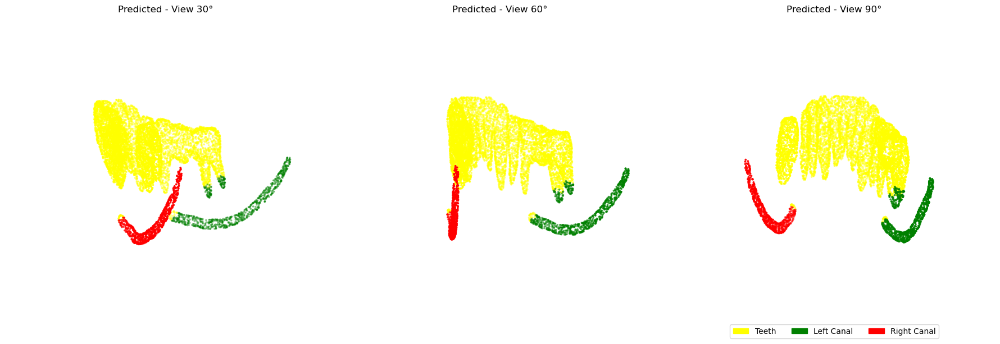

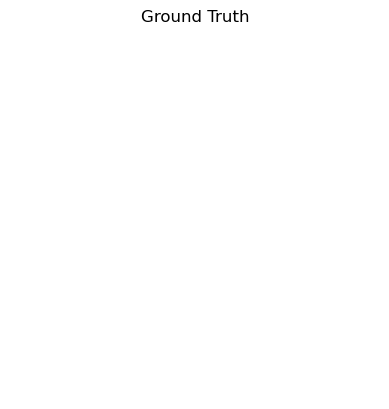

In [9]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.patches as mpatches

# -----------------------------------
# 🧱 2. MeshSegNet Model
# -----------------------------------
class MeshSegNet(nn.Module):
    def __init__(self, in_channels=3, num_classes=3):
        super(MeshSegNet, self).__init__()
        self.conv1 = GCNConv(in_channels, 64)
        self.conv2 = GCNConv(64, 128)
        self.conv3 = GCNConv(128, 256)
        self.classifier = nn.Linear(256, num_classes)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = torch.relu(self.conv1(x, edge_index))
        x = torch.relu(self.conv2(x, edge_index))
        x = torch.relu(self.conv3(x, edge_index))
        x = self.classifier(x)
        return x

# ✅ MeshSegNet class is already defined above — no need to import it again

# Load model
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = MeshSegNet(num_classes=3).to(device)
model.load_state_dict(torch.load("best_meshsegnet_model.pth"))
model.eval()

# Load test data
data = np.load("pointclouds/sample_case_01.npz")
points = torch.tensor(data['pos'], dtype=torch.float32).to(device)
true_labels = data['y'] - 1  # [1,2,3] → [0,1,2]

# Dummy edge_index (MeshSegNet needs full mesh; skip if only testing)
edge_index = torch.zeros((2, points.shape[0]), dtype=torch.long).to(device)

# Create dummy batch
class DummyBatch:
    def __init__(self, x, edge_index):
        self.x = x
        self.edge_index = edge_index
batch = DummyBatch(points, edge_index)

# Predict
with torch.no_grad():
    out = model(batch)
    preds = out.argmax(dim=1).cpu().numpy()

# Save prediction
np.save("predicted_labels_meshsegnet.npy", preds)

# Visualization
def visualize(points, pred_labels, true_labels=None):
    label_colors = {0: 'yellow', 1: 'green', 2: 'red'}
    pred_colors = [label_colors[int(l)] for l in pred_labels]

    fig = plt.figure(figsize=(18, 6))
    for i, angle in enumerate([30, 60, 90]):
        ax = fig.add_subplot(1, 3, i + 1, projection='3d')
        ax.scatter(points[:, 0], points[:, 1], points[:, 2], c=pred_colors, s=3)
        ax.set_title(f"Predicted - View {angle}°")
        ax.view_init(elev=10, azim=angle)
        ax.set_axis_off()

    legend = [mpatches.Patch(color='yellow', label='Teeth'),
              mpatches.Patch(color='green', label='Left Canal'),
              mpatches.Patch(color='red', label='Right Canal')]
    plt.legend(handles=legend, loc='upper center', bbox_to_anchor=(0.5, 0.05), ncol=3)
    plt.tight_layout()
    plt.show()

    if true_labels is not None:
        true_colors = [label_colors[int(l)] for l in true_labels]
        fig_gt = plt.figure()
        ax = fig_gt.add_subplot(111, projection='3d')
        ax.scatter(points[:, 0], points[:, 1], points[:, 2], c=true_colors, s=3)
        ax.set_title("Ground Truth")
        ax.set_axis_off()
        plt.show()

visualize(points.cpu().numpy(), preds, true_labels)


C:\Users\ravimolake\AppData\Local\Temp\ipykernel_9952\177933840.py:119: UserWarning: Glyph 128302 (\N{CRYSTAL BALL}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\ravimolake\AppData\Local\Temp\ipykernel_9952\177933840.py:119: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
C:\Users\ravimolake\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 128302 (\N{CRYSTAL BALL}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
C:\Users\ravimolake\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


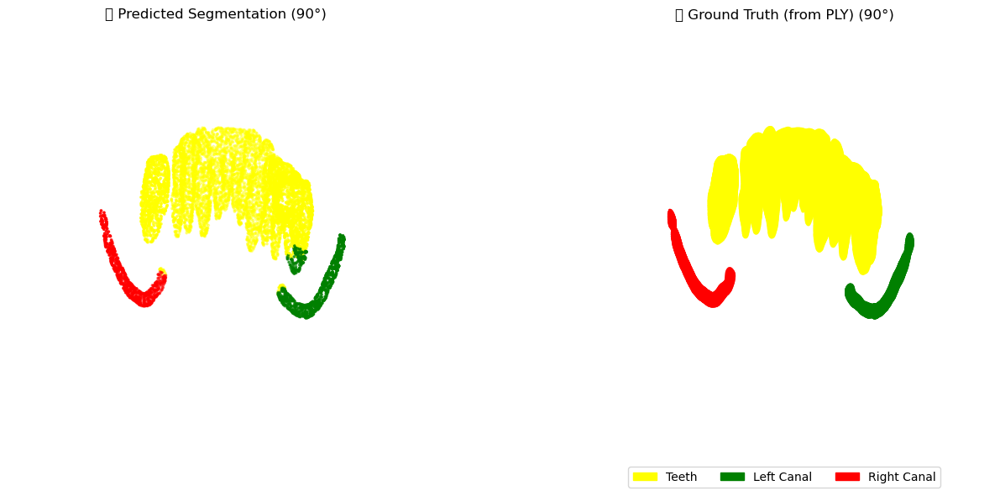

In [10]:
import open3d as o3d
import numpy as np
import torch
import torch.nn as nn
from torch_geometric.nn import GCNConv
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.patches as mpatches

# ----------------------------
# 1. MeshSegNet Definition
# ----------------------------
class MeshSegNet(nn.Module):
    def __init__(self, in_channels=3, num_classes=3):
        super(MeshSegNet, self).__init__()
        self.conv1 = GCNConv(in_channels, 64)
        self.conv2 = GCNConv(64, 128)
        self.conv3 = GCNConv(128, 256)
        self.classifier = nn.Linear(256, num_classes)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = torch.relu(self.conv1(x, edge_index))
        x = torch.relu(self.conv2(x, edge_index))
        x = torch.relu(self.conv3(x, edge_index))
        x = self.classifier(x)
        return x

# ----------------------------
# 2. Load Mesh (GT from PLY)
# ----------------------------
label_mesh_path = r"C:\Users\ravimolake\Downloads\STL\PLY\153858 Segmentation.ply"
mesh = o3d.io.read_triangle_mesh(label_mesh_path)
mesh.compute_vertex_normals()

# Extract GT vertices and vertex colors
gt_vertices = np.asarray(mesh.vertices).astype(np.float32)
gt_colors_raw = (np.asarray(mesh.vertex_colors) * 255).astype(int)

# Map RGB colors to class labels
def color_to_class(rgb):
    color_map = {
        (250, 250, 0): 0,   # Yellow - Teeth
        (255, 0, 0): 1,     # Green - Left Canal (Green in Open3D saved as (255, 0, 0) → adjust this if different)
        (0, 0, 255): 2      # Red - Right Canal
    }
    # Find closest color match
    distances = [np.linalg.norm(np.array(rgb) - np.array(k)) for k in color_map]
    closest_idx = np.argmin(distances)
    return list(color_map.values())[closest_idx]

gt_labels = np.array([color_to_class(rgb) for rgb in gt_colors_raw])

# ----------------------------
# 3. Load Raw Input for Prediction
# ----------------------------
data = np.load("pointclouds/sample_case_01.npz")
input_points = torch.tensor(data['pos'], dtype=torch.float32)

# ----------------------------
# 4. MeshSegNet Inference
# ----------------------------
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = MeshSegNet(num_classes=3).to(device)
model.load_state_dict(torch.load("best_meshsegnet_model.pth", map_location=device))
model.eval()

# Dummy graph edges (for testing only)
edge_index = torch.zeros((2, input_points.shape[0]), dtype=torch.long).to(device)

class DummyBatch:
    def __init__(self, x, edge_index):
        self.x = x
        self.edge_index = edge_index

batch = DummyBatch(input_points.to(device), edge_index)

with torch.no_grad():
    preds = model(batch).argmax(dim=1).cpu().numpy()

# ----------------------------
# 5. Color Mapping
# ----------------------------
label_colors = {
    0: 'yellow',  # Teeth
    1: 'green',   # Left Canal
    2: 'red'      # Right Canal
}

# ----------------------------
# 6. Matplotlib Visualization (Prediction & GT side-by-side)
# ----------------------------
fig = plt.figure(figsize=(14, 6))

# --- Prediction ---
ax1 = fig.add_subplot(1, 2, 1, projection='3d')
pred_colors = [label_colors[int(l)] for l in preds]
ax1.scatter(input_points[:, 0], input_points[:, 1], input_points[:, 2], c=pred_colors, s=3)
ax1.set_title("🔮 Predicted Segmentation (90°)")
ax1.view_init(elev=10, azim=90)
ax1.set_axis_off()

# --- Ground Truth ---
ax2 = fig.add_subplot(1, 2, 2, projection='3d')
gt_colors = [label_colors[int(l)] for l in gt_labels]
ax2.scatter(gt_vertices[:, 0], gt_vertices[:, 1], gt_vertices[:, 2], c=gt_colors, s=3)
ax2.set_title("✅ Ground Truth (from PLY) (90°)")
ax2.view_init(elev=10, azim=90)
ax2.set_axis_off()

# Legend
legend = [
    mpatches.Patch(color='yellow', label='Teeth'),
    mpatches.Patch(color='green', label='Left Canal'),
    mpatches.Patch(color='red', label='Right Canal')
]
plt.legend(handles=legend, loc='upper center', bbox_to_anchor=(0.5, -0.05), ncol=3)

plt.tight_layout()
plt.show()


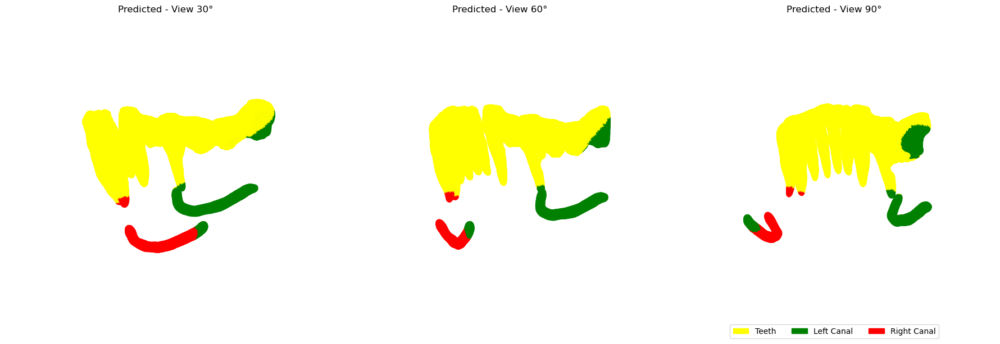

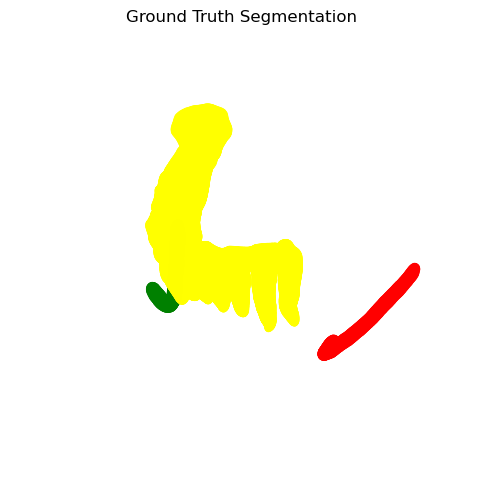

In [11]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.patches as mpatches

# -----------------------------
# 🎨 3D Visualization Function with Multiple Angles & Legend
# -----------------------------
def visualize_mesh_segmentation_matplotlib(points, pred_labels, true_labels=None):
    # Define class colors
    label_colors = {
        0: 'yellow',  # Teeth
        1: 'green',   # Left Mandibular Canal
        2: 'red'      # Right Mandibular Canal
    }

    # Map predicted labels to colors
    pred_colors = [label_colors[int(lbl)] for lbl in pred_labels]

    fig = plt.figure(figsize=(18, 6))

    # --- Predicted Segmentation (3 angles) ---
    for i, angle in enumerate([30, 60, 90]):
        ax = fig.add_subplot(1, 3, i+1, projection='3d')
        ax.scatter(points[:, 0], points[:, 1], points[:, 2], c=pred_colors, s=3)
        ax.set_title(f"Predicted - View {angle}°")
        ax.view_init(elev=10, azim=angle)
        ax.set_axis_off()

    # Add legend
    legend_patches = [
        mpatches.Patch(color='yellow', label='Teeth'),
        mpatches.Patch(color='green', label='Left Canal'),
        mpatches.Patch(color='red', label='Right Canal')
    ]
    plt.legend(handles=legend_patches, loc='upper center', bbox_to_anchor=(0.5, 0.05), ncol=3)

    plt.tight_layout()
    plt.show()

    # --- Optional: Ground Truth Visualization (Separate Window) ---
    if true_labels is not None:
        true_colors = [label_colors[int(lbl)] for lbl in true_labels]
        fig_gt = plt.figure(figsize=(6, 6))
        ax_gt = fig_gt.add_subplot(111, projection='3d')
        ax_gt.scatter(points[:, 0], points[:, 1], points[:, 2], c=true_colors, s=3)
        ax_gt.set_title("Ground Truth Segmentation")
        ax_gt.set_axis_off()
        plt.show()

# -----------------------------
# 🧪 Inference + Visualization using Best Model
# -----------------------------
# ✅ Load best model before inference
model.load_state_dict(torch.load("best_meshsegnet_model.pth"))
model.eval()

with torch.no_grad():
    batch = next(iter(val_loader)).to(device)
    out = model(batch)  # Shape: [N, 3]

    preds = out.argmax(dim=1)             # Shape: [N]
    pred_labels = preds.cpu().numpy()     # numpy array of predicted classes
    true_labels = batch.y.cpu().numpy()   # Ground truth labels
    points = batch.x.cpu().numpy()        # Input point coordinates

    visualize_mesh_segmentation_matplotlib(points, pred_labels, true_labels)


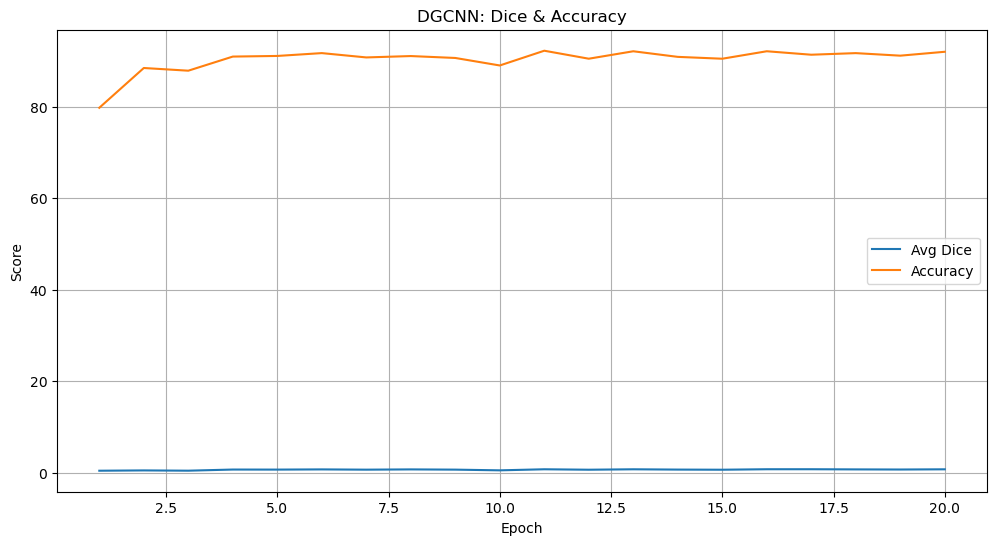

In [12]:
import json
import matplotlib.pyplot as plt

# 📁 Save metrics
metrics = {
    "losses": total_losses,
    "dice_teeth": dice_scores_class1,
    "dice_left": dice_scores_class2,
    "dice_right": dice_scores_class3,
    "avg_dice": avg_dice_scores,
    "accuracy": overall_accuracies
}
with open("metrics_meshsegnet.json", "w") as f:
    json.dump(metrics, f)  # 🔁 Change filename for each model

# 📊 Plot
epochs = range(1, len(avg_dice_scores) + 1)
plt.figure(figsize=(12, 6))
plt.plot(epochs, avg_dice_scores, label='Avg Dice')
plt.plot(epochs, overall_accuracies, label='Accuracy')
plt.title("MeshSegNet: Dice & Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Score")
plt.legend()
plt.grid(True)
plt.show()


In [13]:
import plotly.graph_objs as go

def visualize_pointcloud_plotly(points, pred_labels, true_labels=None):
    color_map = {
        0: 'yellow',  # Teeth
        1: 'green',   # Left Canal
        2: 'red'      # Right Canal
    }

    pred_colors = [color_map[int(c)] for c in pred_labels]
    traces = []

    # 🔵 Predicted Segmentation (original position)
    traces.append(go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=dict(size=3, color=pred_colors),
        name="Prediction"
    ))

    # 🟡 Ground Truth (slightly shifted to avoid overlap)
    if true_labels is not None:
        offset = 15  # adjust this if needed
        gt_colors = [color_map[int(c)] for c in true_labels]
        traces.append(go.Scatter3d(
            x=points[:, 0] + offset,  # shift along X
            y=points[:, 1],
            z=points[:, 2],
            mode='markers',
            marker=dict(size=3, color=gt_colors),
            name="Ground Truth"
        ))

    layout = go.Layout(
        title="3D Segmentation: Prediction vs Ground Truth (Shifted)",
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z'
        ),
        margin=dict(l=0, r=0, b=0, t=40)
    )

    fig = go.Figure(data=traces, layout=layout)
    fig.show()


In [14]:
model.load_state_dict(torch.load("best_meshsegnet_model.pth"))
model.eval()

with torch.no_grad():
    batch = next(iter(val_loader)).to("cuda" if torch.cuda.is_available() else "cpu")
    out = model(batch)

    preds = out.argmax(dim=1)
    pred_labels = preds.cpu().numpy()
    true_labels = batch.y.cpu().numpy()
    points = batch.x.cpu().numpy()

    visualize_pointcloud_plotly(points, pred_labels, true_labels)


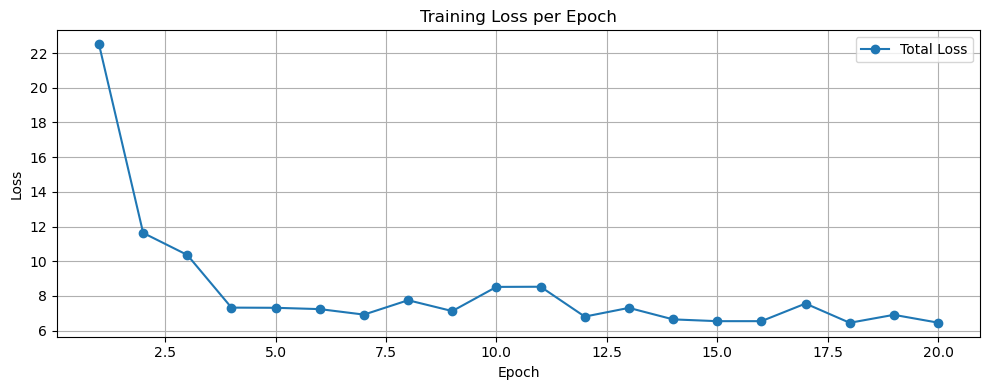

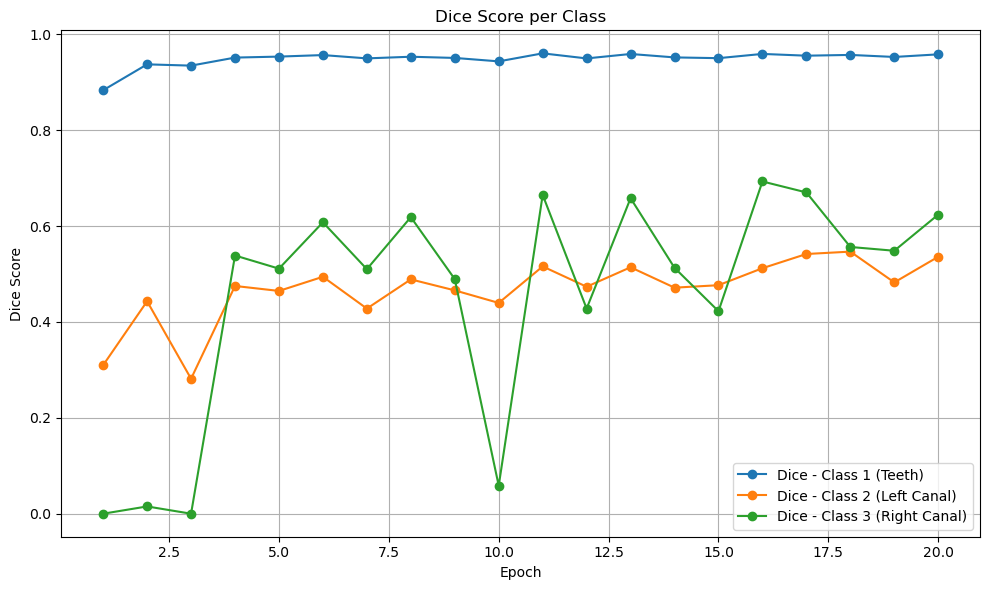

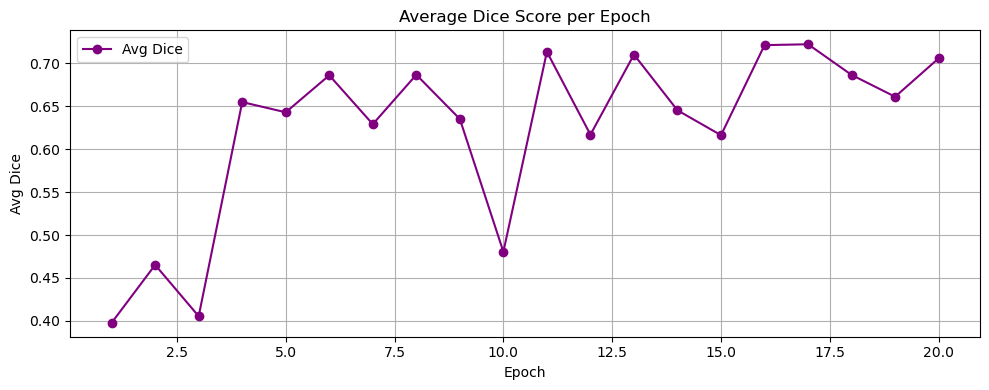

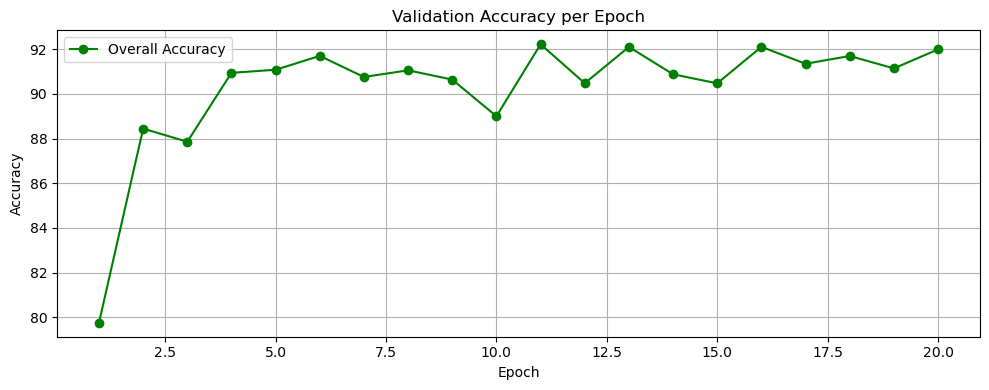

In [15]:
import matplotlib.pyplot as plt

epochs = list(range(1, len(total_losses) + 1))

# 📉 1. Total Loss vs Epochs
plt.figure(figsize=(10, 4))
plt.plot(epochs, total_losses, marker='o', label='Total Loss')
plt.title("Training Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

# 🎯 2. Dice Score per Class
plt.figure(figsize=(10, 6))
plt.plot(epochs, dice_scores_class1, label="Dice - Class 1 (Teeth)", marker='o')
plt.plot(epochs, dice_scores_class2, label="Dice - Class 2 (Left Canal)", marker='o')
plt.plot(epochs, dice_scores_class3, label="Dice - Class 3 (Right Canal)", marker='o')
plt.title("Dice Score per Class")
plt.xlabel("Epoch")
plt.ylabel("Dice Score")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

# 📊 3. Avg Dice Score
plt.figure(figsize=(10, 4))
plt.plot(epochs, avg_dice_scores, label="Avg Dice", color='purple', marker='o')
plt.title("Average Dice Score per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Avg Dice")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

# ✅ 4. Accuracy per Epoch
plt.figure(figsize=(10, 4))
plt.plot(epochs, overall_accuracies, label="Overall Accuracy", color='green', marker='o')
plt.title("Validation Accuracy per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


In [16]:
import open3d as o3d
import numpy as np

# === Load base mesh ===
mesh = o3d.io.read_triangle_mesh("input_mesh.ply")

# === Load labels ===
gt_labels = np.load("ground_truth_labels.npy")     # Ground Truth Labels [num_vertices]
pred_labels = np.load("predicted_labels.npy")      # Predicted Labels [num_vertices]

# === Color map per class ===
label_colors = {
    1: [1.0, 1.0, 0.0],  # Class 1 - Yellow (Lower Teeth)
    2: [0.0, 0.0, 1.0],  # Class 2 - Blue (Left Canal)
    3: [1.0, 0.0, 0.0],  # Class 3 - Red (Right Canal)
}

# === Save ground truth mesh ===
gt_colors = np.array([label_colors.get(int(lbl), [0, 0, 0]) for lbl in gt_labels])
gt_mesh = mesh.clone()
gt_mesh.vertex_colors = o3d.utility.Vector3dVector(gt_colors)
o3d.io.write_triangle_mesh("ground_truth.ply", gt_mesh)
print("✅ Saved: ground_truth.ply")

# === Save prediction mesh ===
pred_colors = np.array([label_colors.get(int(lbl), [0, 0, 0]) for lbl in pred_labels])
pred_mesh = mesh.clone()
pred_mesh.vertex_colors = o3d.utility.Vector3dVector(pred_colors)
o3d.io.write_triangle_mesh("prediction.ply", pred_mesh)
print("✅ Saved: prediction.ply")


[Open3D WARNING] Read PLY failed: unable to open file: input_mesh.ply


FileNotFoundError: [Errno 2] No such file or directory: 'ground_truth_labels.npy'

In [ ]:
import pyvista as pv
import numpy as np

# Paths to mesh files (update with your own)
gt_ply_path = "ground_truth.ply"
pred_ply_path = "prediction.ply"

# Load meshes
gt_mesh = pv.read(gt_ply_path)
pred_mesh = pv.read(pred_ply_path)

# Extract per-vertex labels
gt_labels = gt_mesh["label"] if "label" in gt_mesh.array_names else np.zeros(gt_mesh.n_points, dtype=np.uint8)
pred_labels = pred_mesh["label"] if "label" in pred_mesh.array_names else np.zeros(pred_mesh.n_points, dtype=np.uint8)

# Color-coding function
def get_label_colors(gt_labels, pred_labels):
    colors = np.zeros((gt_labels.shape[0], 3), dtype=np.uint8)
    for i in range(gt_labels.shape[0]):
        if gt_labels[i] == pred_labels[i] and gt_labels[i] != 0:
            colors[i] = [0, 255, 0]      # ✅ Green: Correct
        elif gt_labels[i] != 0 and pred_labels[i] == 0:
            colors[i] = [255, 0, 0]      # ❌ Red: Missed (False Negative)
        elif gt_labels[i] == 0 and pred_labels[i] != 0:
            colors[i] = [0, 0, 255]      # ❌ Blue: Wrong (False Positive)
        else:
            colors[i] = [150, 150, 150]  # Grey: Background
    return colors

# Assign colors to predicted mesh
colors = get_label_colors(gt_labels, pred_labels)
overlay_mesh = pred_mesh.copy()
overlay_mesh.point_data["overlay_color"] = colors

# 🔷 Save Figure 4.5.1 - Full Overlay View
plotter1 = pv.Plotter(off_screen=True)
plotter1.add_mesh(overlay_mesh, scalars="overlay_color", rgb=True, show_edges=False)
plotter1.view_isometric()
plotter1.screenshot("figure_4_5_1_overlay_full.png")

# 🔷 Save Figure 4.5.2 - Zoomed Cross-Section View
xmin, xmax, ymin, ymax, zmin, zmax = overlay_mesh.bounds
z_cut = zmin + (zmax - zmin) * 0.2
clipped = overlay_mesh.clip_box(bounds=(xmin, xmax, ymin, ymax, zmin, z_cut), invert=False)

plotter2 = pv.Plotter(off_screen=True)
plotter2.add_mesh(clipped, scalars="overlay_color", rgb=True, show_edges=True)
plotter2.view_xy()
plotter2.screenshot("figure_4_5_2_zoomed_section.png")
